This uses the https://www.kaggle.com/bulentsiyah/semantic-drone-dataset# that I got from Kaggle. Here's the link to the original version: https://www.tugraz.at/index.php?id=22387

In [1]:
import imageio

import random

import cv2
from matplotlib import pyplot as plt

import albumentations as A
from typing import List

from mpl_toolkits.axes_grid1 import ImageGrid
import numpy as np

You can find some examples here: https://github.com/albumentations-team/albumentations_examples#augmentations-examples

In [2]:
def visualize(image, mask, original_image=None, original_mask=None):
    fontsize = 18
    
    if original_image is None and original_mask is None:
        f, ax = plt.subplots(2, 1, figsize=(8, 8))

        ax[0].imshow(image)
        ax[1].imshow(mask)
    else:
        f, ax = plt.subplots(2, 2, figsize=(8, 8))

        ax[0, 0].imshow(original_image)
        ax[0, 0].set_title('Original image', fontsize=fontsize)
        
        ax[1, 0].imshow(original_mask)
        ax[1, 0].set_title('Original mask', fontsize=fontsize)
        
        ax[0, 1].imshow(image)
        ax[0, 1].set_title('Transformed image', fontsize=fontsize)
        
        ax[1, 1].imshow(mask)
        ax[1, 1].set_title('Transformed mask', fontsize=fontsize)

In [3]:
image = imageio.imread('semseg_image.jpg')
mask = imageio.imread('semseg_label.png')

In [4]:
image

Array([[[136, 134,  31],
        [139, 140,  38],
        [134, 136,  37],
        ...,
        [ 24,  26,  39],
        [ 27,  26,  40],
        [ 29,  27,  41]],

       [[134, 132,  31],
        [137, 135,  34],
        [131, 133,  32],
        ...,
        [ 24,  26,  39],
        [ 27,  26,  40],
        [ 28,  26,  40]],

       [[141, 137,  37],
        [141, 139,  39],
        [134, 134,  36],
        ...,
        [ 24,  26,  39],
        [ 26,  25,  39],
        [ 27,  25,  39]],

       ...,

       [[108, 117, 126],
        [107, 116, 125],
        [106, 113, 123],
        ...,
        [107, 111, 114],
        [100, 105, 111],
        [ 97, 101, 110]],

       [[107, 122, 127],
        [109, 122, 128],
        [107, 120, 126],
        ...,
        [100, 105, 109],
        [ 96, 100, 111],
        [ 98, 101, 116]],

       [[105, 123, 123],
        [106, 124, 126],
        [106, 121, 124],
        ...,
        [ 90,  97, 107],
        [ 90,  93, 108],
        [ 95,  98, 117]]

In [5]:
mask

Array([[0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 1, 1, 1],
       [0, 0, 0, ..., 1, 1, 1],
       ...,
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0]], dtype=uint8)

In [6]:
np.unique(mask, return_counts=True)

(Array([ 0,  1,  2,  4,  8, 10, 15, 19, 22], dtype=uint8),
 array([   60393, 20883680,   293514,   633602,   211227,   287613,
          524123,   589714,   516134], dtype=int64))

In [7]:
print(image.shape, mask.shape)


(4000, 6000, 3) (4000, 6000)


OpenCV uses BGR internally, so you might need to switch it. This is fine unless you read it with opencv and try to plot it with, say matplotlib. Then you'll need to switch the channels around.

In [8]:
original_height, original_width = image.shape[:2]


In [9]:
original_height

4000

The image is bigger than we'll need, so let's resize it first

In [10]:
downsize_factor = 6
image = image[::downsize_factor, ::downsize_factor]
mask = mask[::downsize_factor, ::downsize_factor]

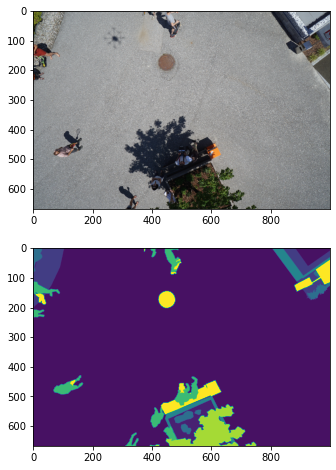

In [11]:
visualize(image, mask)


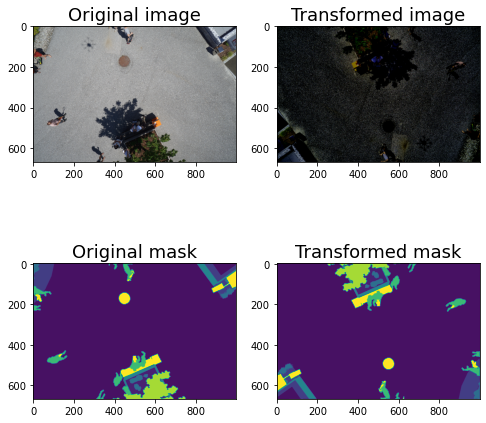

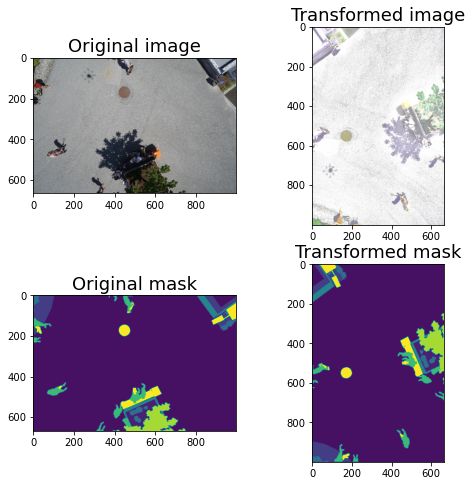

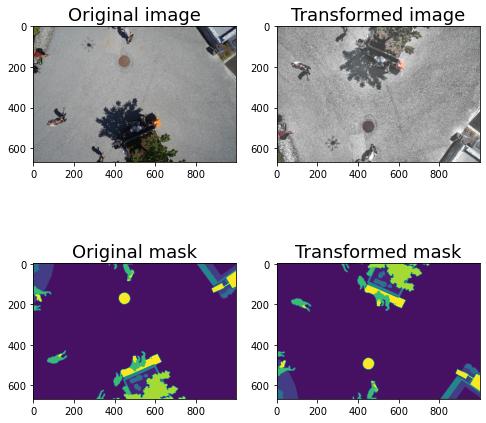

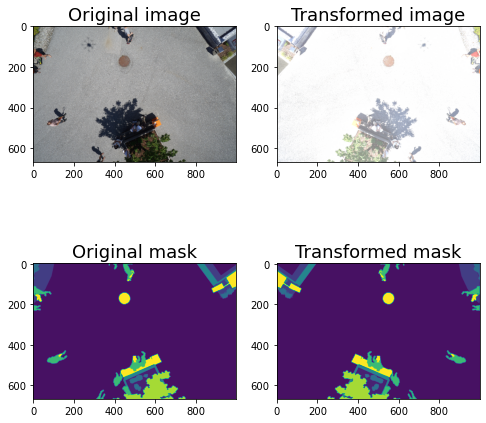

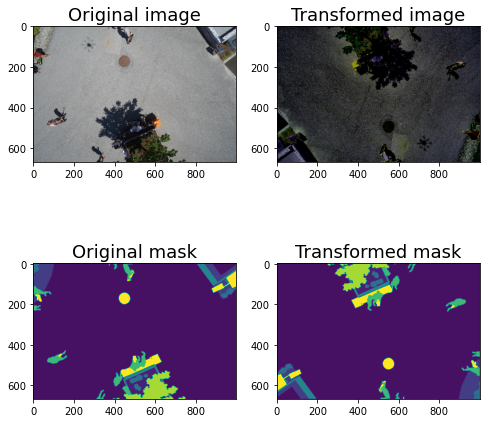

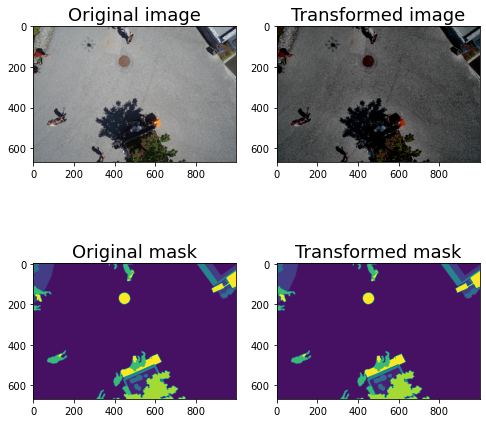

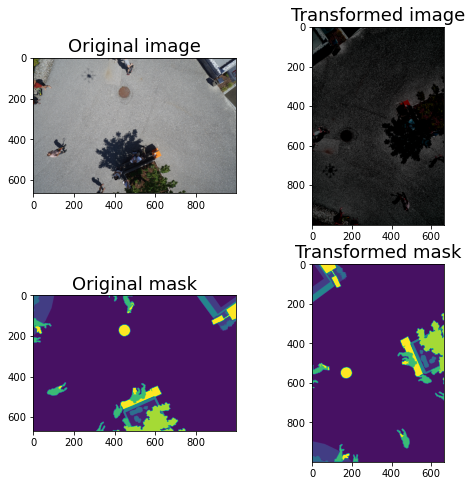

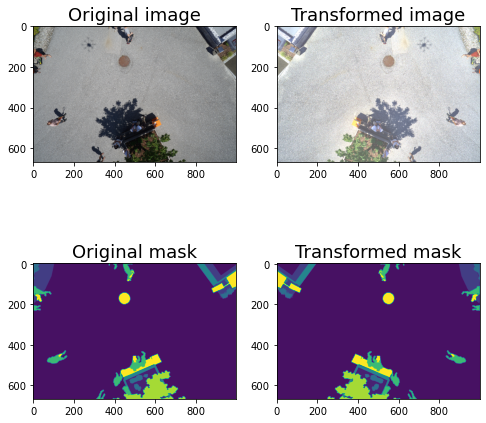

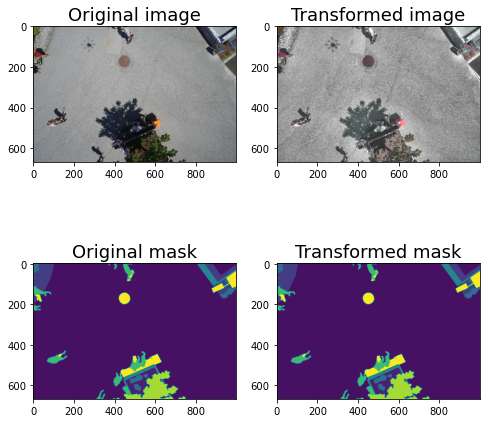

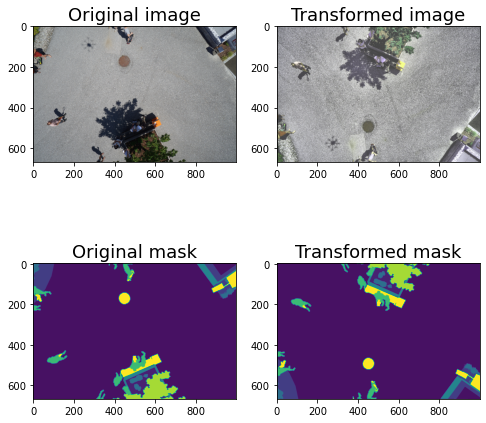

In [12]:
augments = A.Compose([
    A.CLAHE(p=1),
    A.HueSaturationValue(hue_shift_limit=20, sat_shift_limit=30, val_shift_limit=50, p=1),
    A.RandomBrightnessContrast(brightness_limit=0.5, p=1),
    A.Transpose(p=0.5),
    A.VerticalFlip(p=0.5),
    A.HorizontalFlip(p=0.5)
], p=1)

for i in range(10):
    augmented = augments(image=image, mask=mask)

    image_scaled = augmented['image']
    mask_scaled = augmented['mask']

    visualize(image_scaled, mask_scaled, original_image=image, original_mask=mask)

### Spatial augmentations

There are eight different alignments that an image could be in and my goal is to make each of them equally likely. Using the following setup, each position will have a 12.5% chance of being selected.

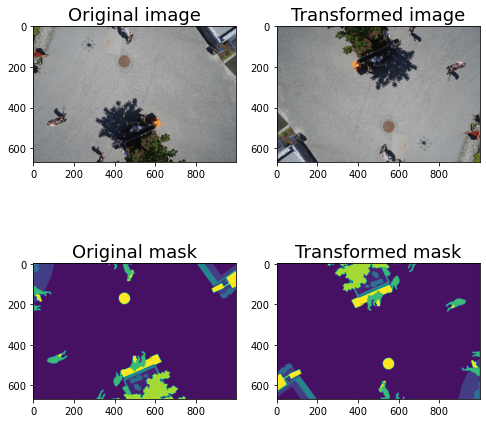

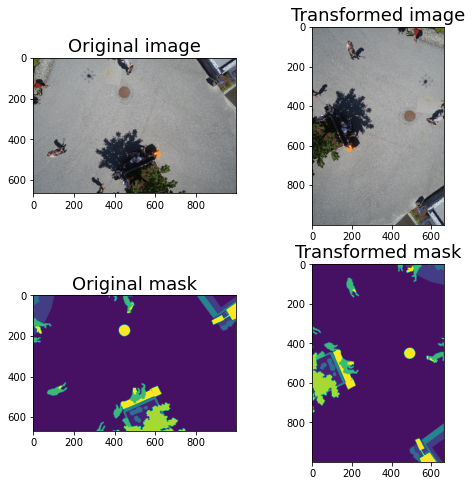

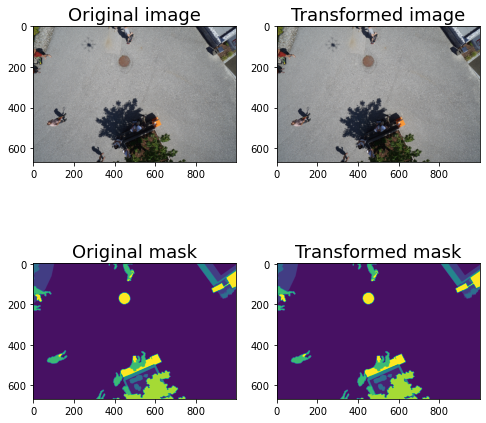

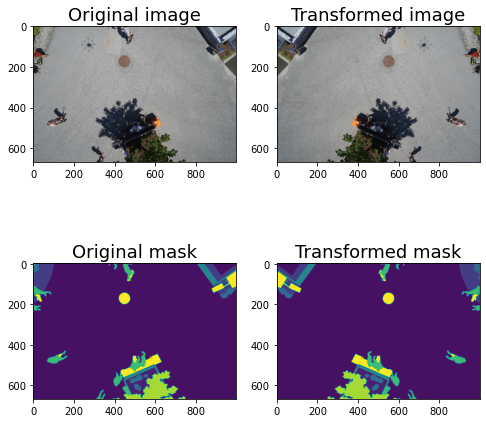

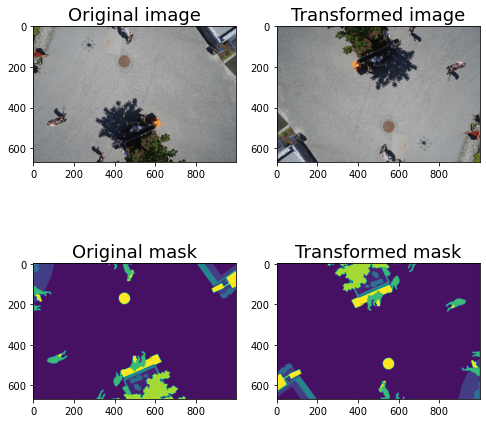

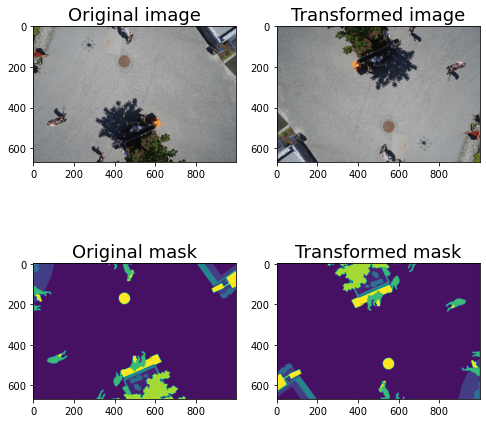

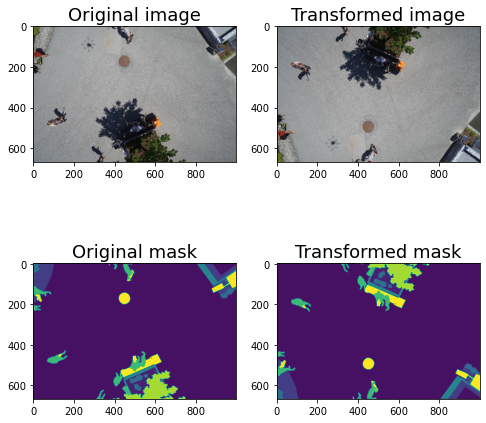

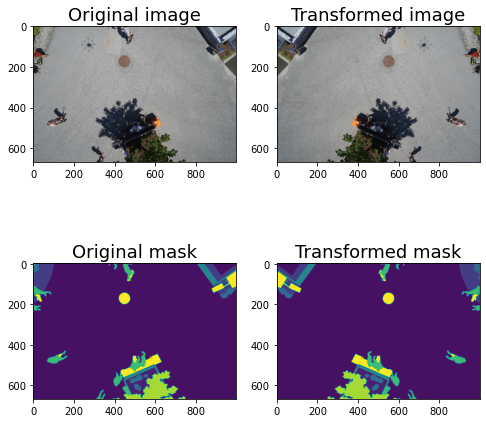

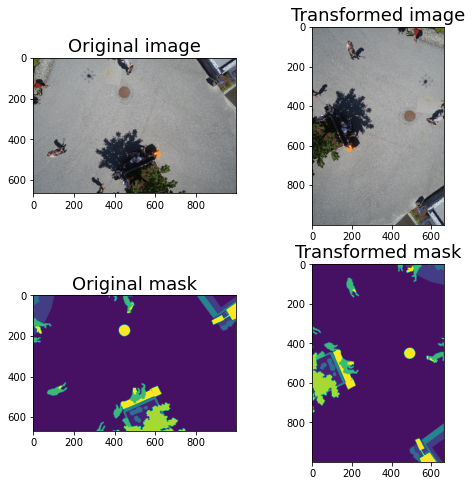

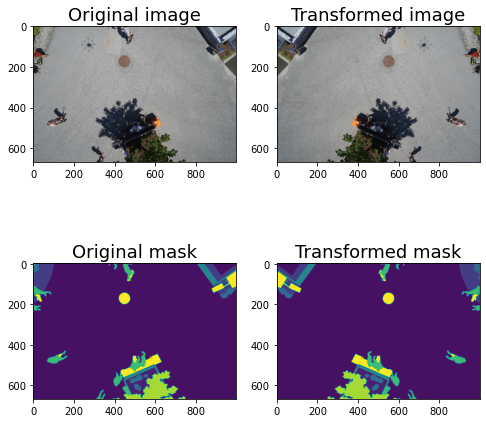

In [13]:
augments = A.Compose([
    A.Transpose(p=0.5),
    A.VerticalFlip(p=0.5),
    A.HorizontalFlip(p=0.5),
    
])

for i in range(10):
    augmented = augments(image=image, mask=mask)

    image_scaled = augmented['image']
    mask_scaled = augmented['mask']

    visualize(image_scaled, mask_scaled, original_image=image, original_mask=mask)

There is also `A.RandomRotate90(p=0.5)` but I don't recommend it. The above are all you need

Contrast Limited Adaptive Histogram Equalization
I keep the clip_limit as the default. It 

## Pixel-level augmentations

These by default don't change the segmentation label, so we won't need to include that.

### CLAHE

Contrast Limited Adaptive Histogram Equalization (CLAHE) is a good option. I usually include it and leave it in the defaults. This by default does a range, so you'll have to see it multiple times

To specify this, you usually set a clip limit and it randomly chooses a value between 1 and your specified limit. This means that you get a different value each time you run it. To fix it to be the same, I'm going to set the value as both the high and the low to see that exact value. In practice I wouldn't do this.

In [14]:
def visualize_no_mask(image, mask, original_image=None, original_mask=None):
    fontsize = 18
    
    if original_image is None and original_mask is None:
        f, ax = plt.subplots(2, 1, figsize=(8, 8))

        ax[0].imshow(image)
        ax[1].imshow(mask)
    else:
        f, ax = plt.subplots(2, 2, figsize=(8, 8))

        ax[0, 0].imshow(original_image)
        ax[0, 0].set_title('Original image', fontsize=fontsize)
        
        ax[1, 0].imshow(original_mask)
        ax[1, 0].set_title('Original mask', fontsize=fontsize)
        
        ax[0, 1].imshow(image)
        ax[0, 1].set_title('Transformed image', fontsize=fontsize)
        
        ax[1, 1].imshow(mask)
        ax[1, 1].set_title('Transformed mask', fontsize=fontsize)

In [15]:
def vizzy(augmented_images: List, fontsize = 18):

    fig = plt.figure(figsize=(16., 16.))
    grid = ImageGrid(fig, 111,
                     nrows_ncols=(3, 3),
                     axes_pad=0.5,
                     )

    for ax, im in zip(grid, augmented_images):
        # Iterating over the grid returns the Axes.
        ax.imshow(im)
        #ax.set_title('Augmented Image', fontsize=fontsize)

    plt.show()

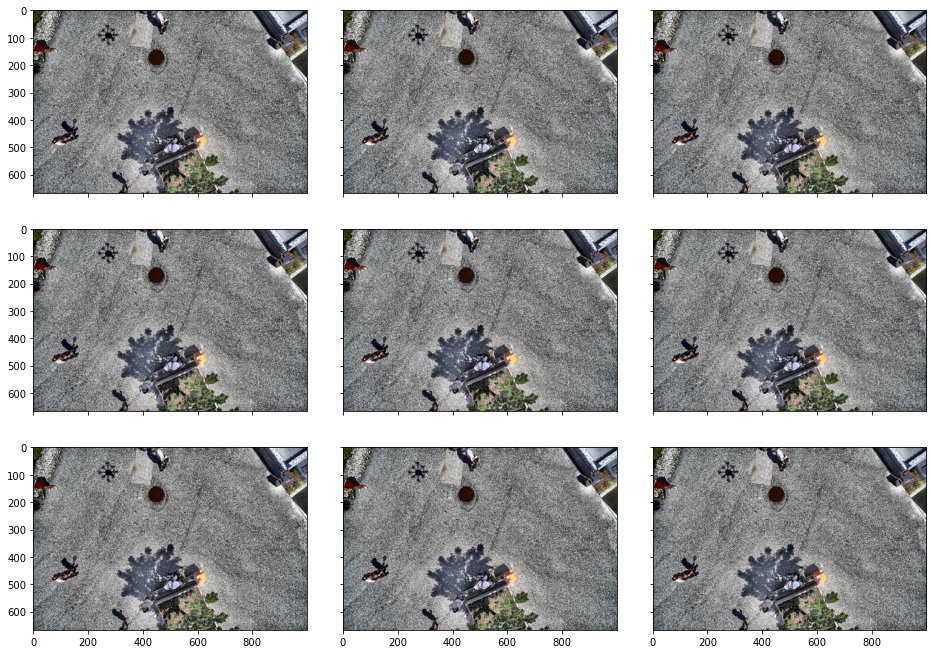

In [16]:
augments = A.Compose([
        A.CLAHE(clip_limit=50, p=1)
])
aug_images = []
for i in range(9):
    augmented = augments(image=image, mask=mask)

    aug_images.append(augmented['image'])

vizzy(aug_images)

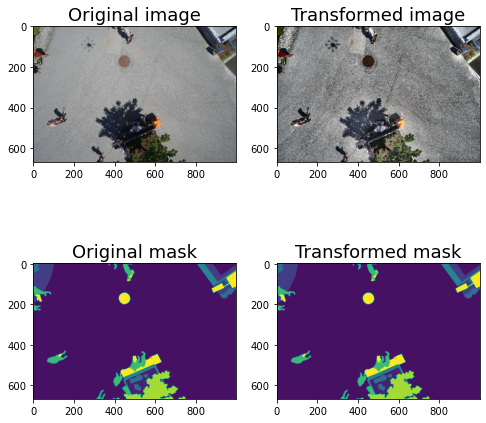

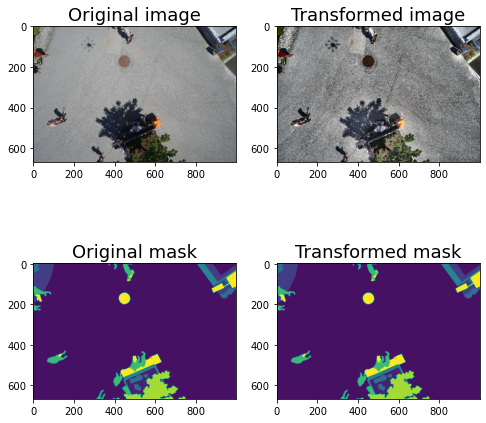

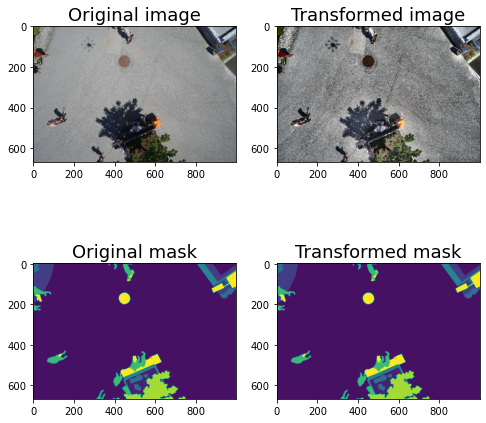

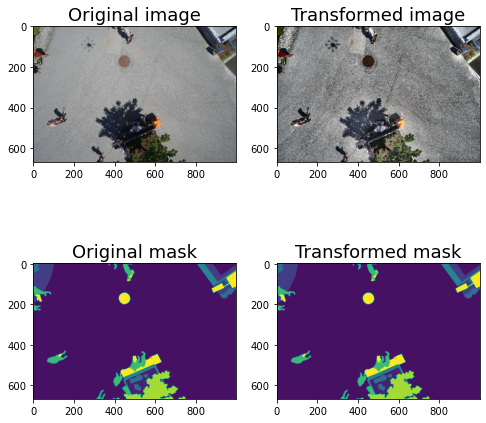

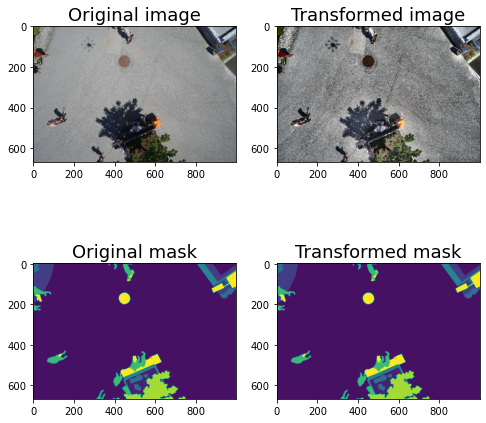

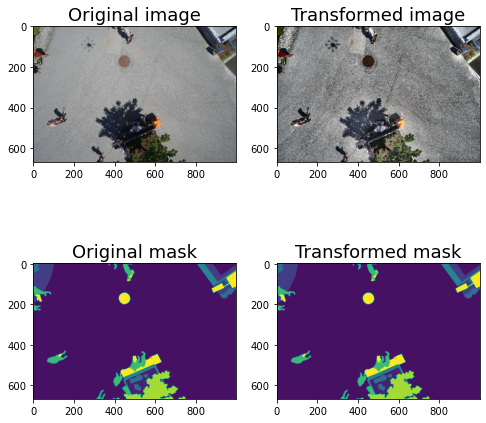

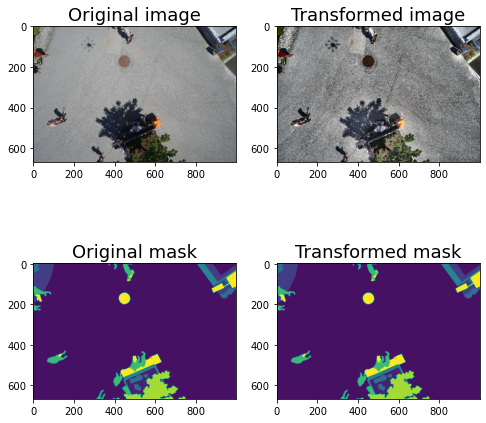

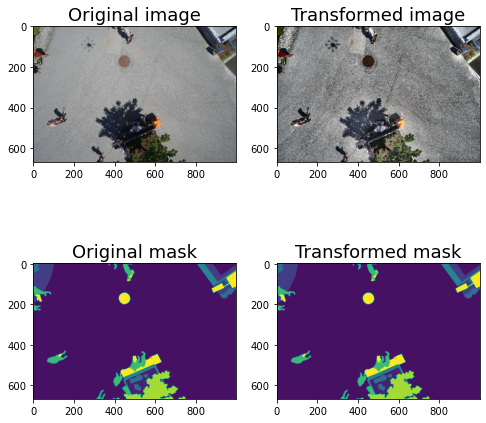

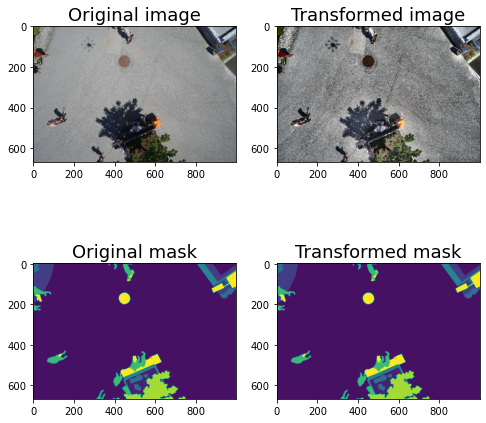

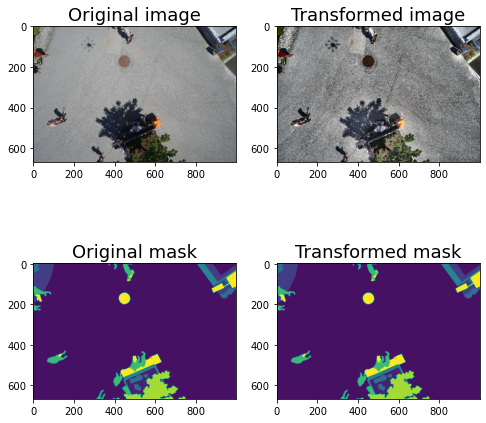

In [17]:
augments = A.Compose([
        A.CLAHE(clip_limit=(4.0, 4.0), p=1),
])
for i in range(10):
    augmented = augments(image=image, mask=mask)

    image_scaled = augmented['image']
    mask_scaled = augmented['mask']

    visualize(image_scaled, mask_scaled, original_image=image, original_mask=mask)

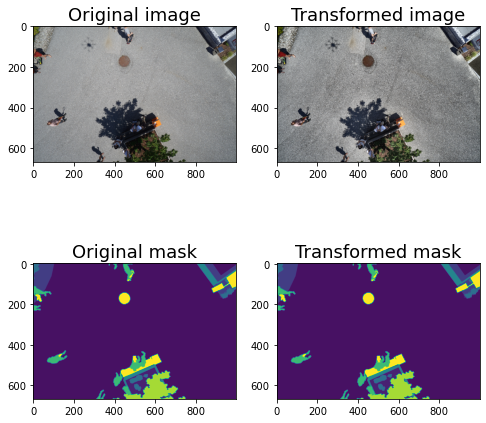

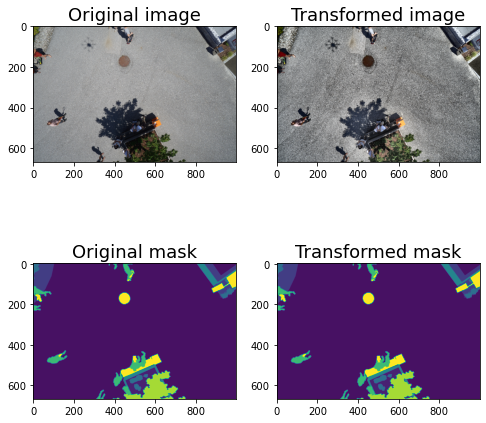

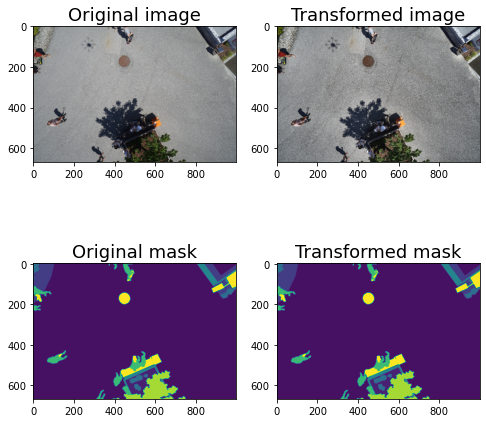

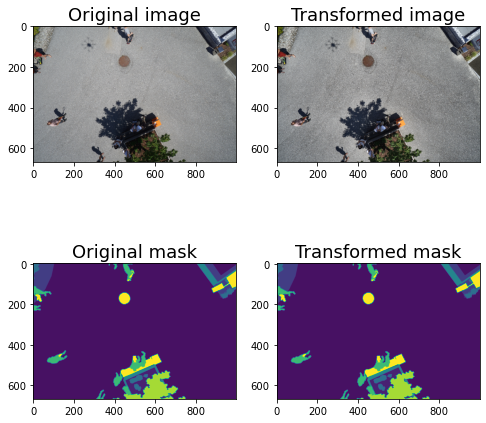

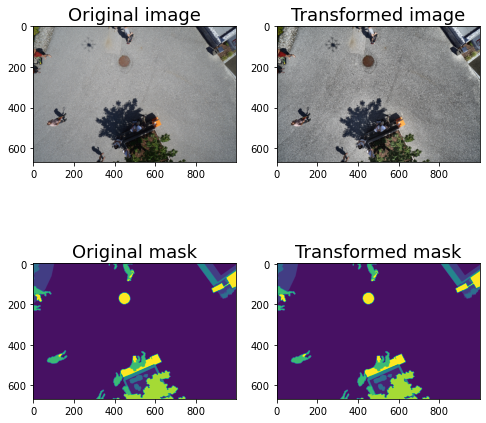

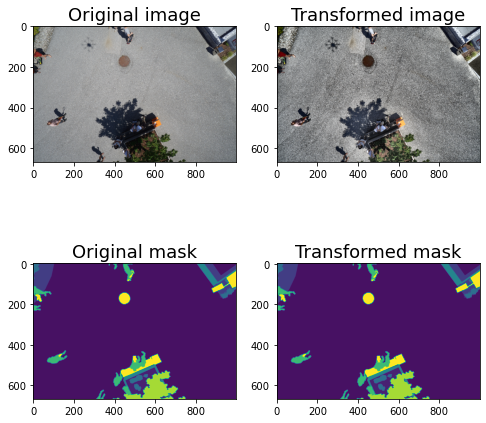

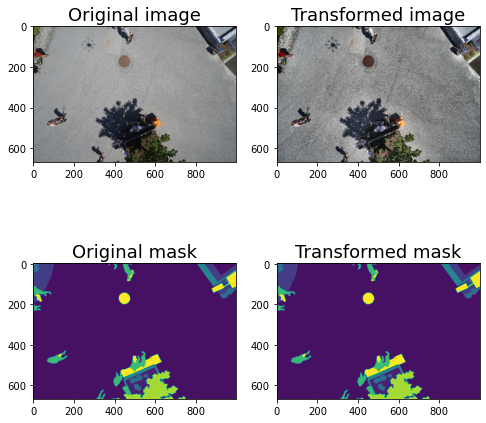

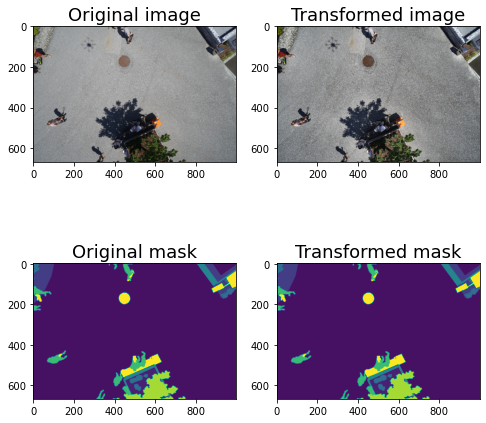

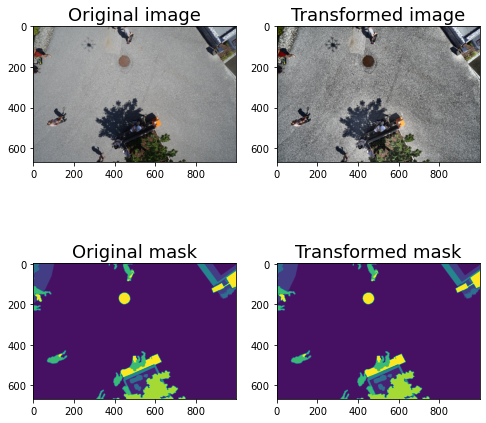

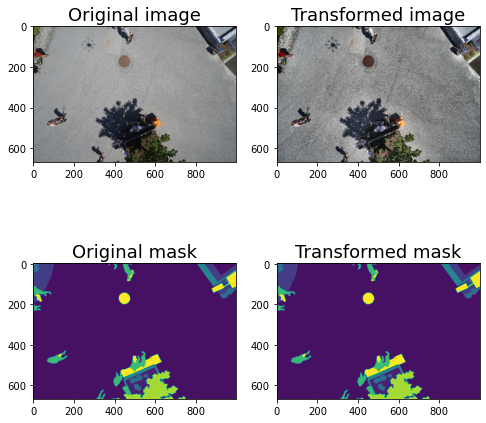

In [18]:
augments = A.Compose([
        A.CLAHE(p=0.8),
])
for i in range(10):
    augmented = augments(image=image, mask=mask)

    image_scaled = augmented['image']
    mask_scaled = augmented['mask']

    visualize(image_scaled, mask_scaled, original_image=image, original_mask=mask)

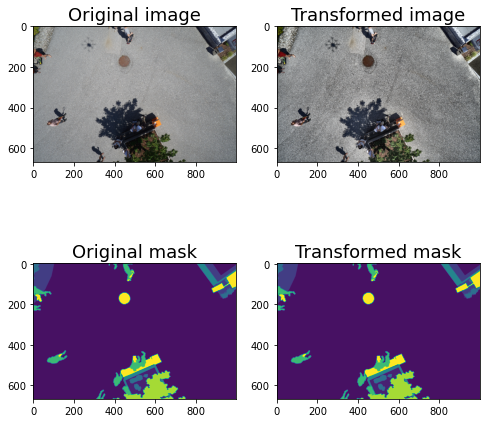

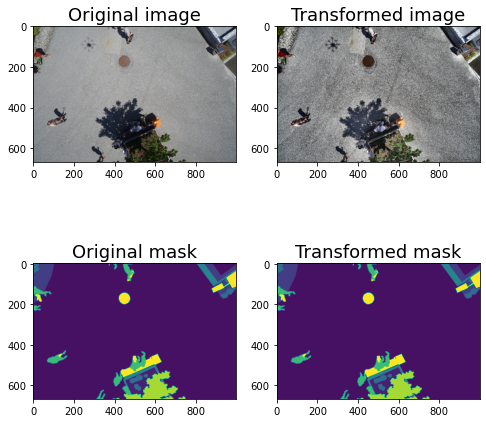

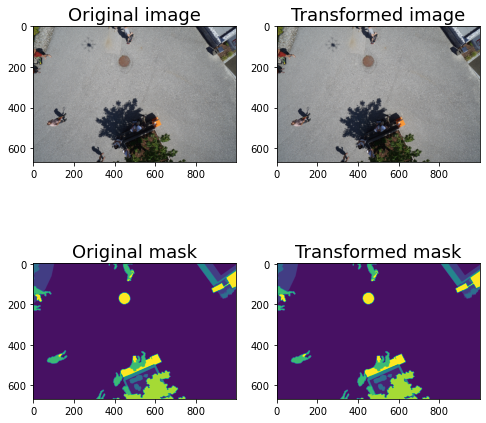

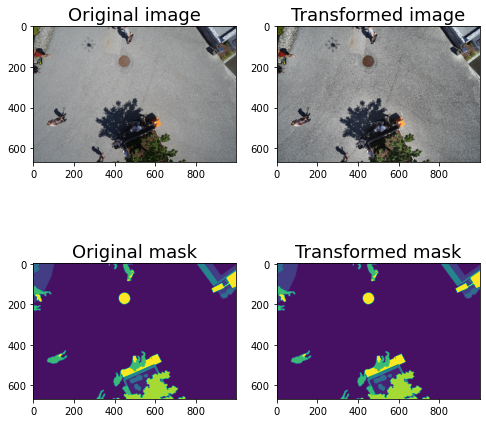

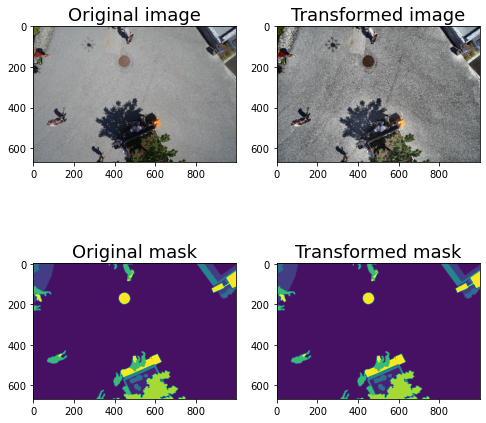

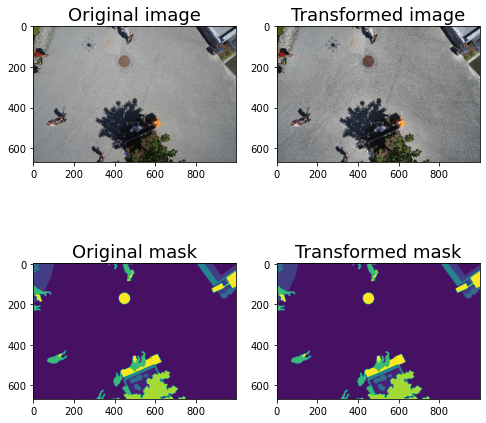

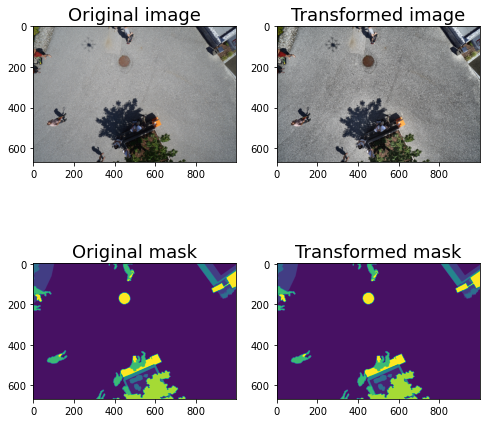

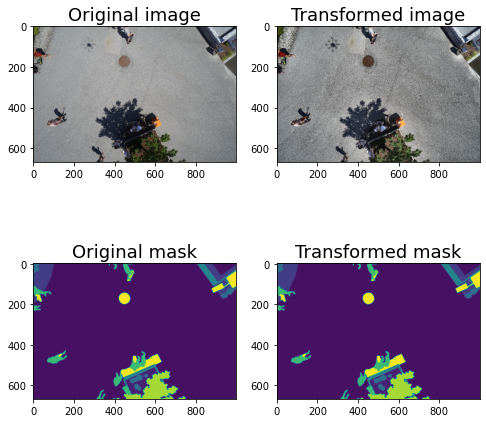

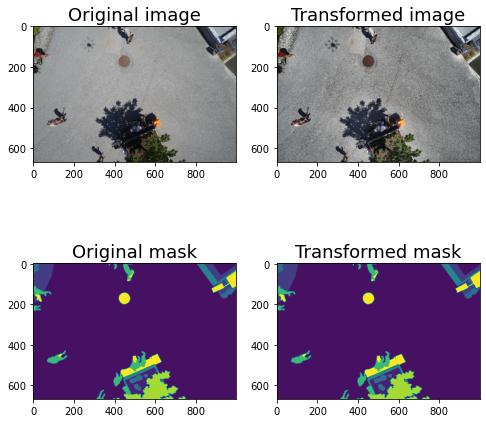

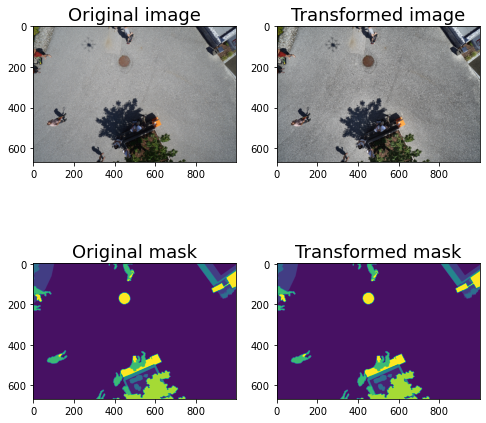

In [19]:
augments = A.Compose([
        A.CLAHE(p=0.8),
])
for i in range(10):
    augmented = augments(image=image, mask=mask)

    image_scaled = augmented['image']
    mask_scaled = augmented['mask']

    visualize(image_scaled, mask_scaled, original_image=image, original_mask=mask)

### Equalize

Another good one is equalize

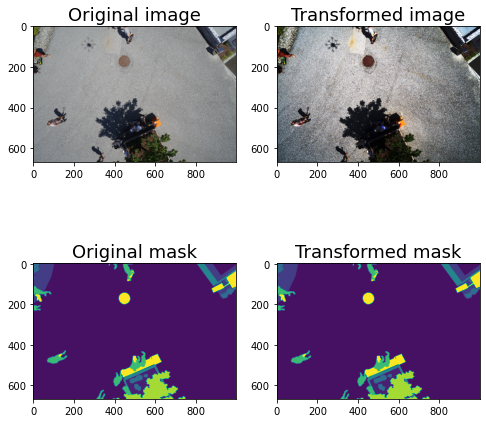

In [20]:
augments = A.Compose([
        A.Equalize(p=1),
])

augmented = augments(image=image, mask=mask)

image_scaled = augmented['image']
mask_scaled = augmented['mask']

visualize(image_scaled, mask_scaled, original_image=image, original_mask=mask)

This just equalizes the image histogram. I wouldn't use it during training unless you also planned to use it during test time.

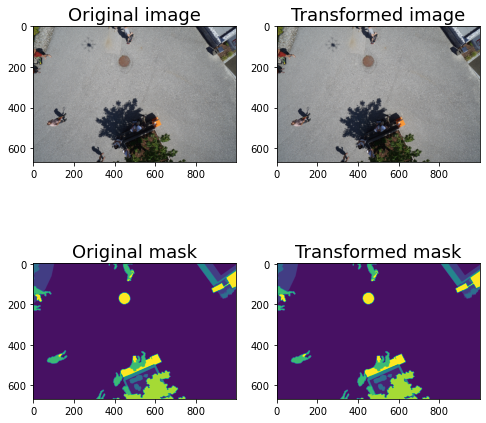

In [21]:
augments = A.Compose([
        A.Equalize(p=1),
])

aug_ims = []
augmented = augments(image=image, mask=mask)

aug_ims.append(augmented['image'])
augmented_image = augmented['image']
augmented_mask = augmented['mask']

visualize_no_mask(image, mask, original_image=image, original_mask=mask)

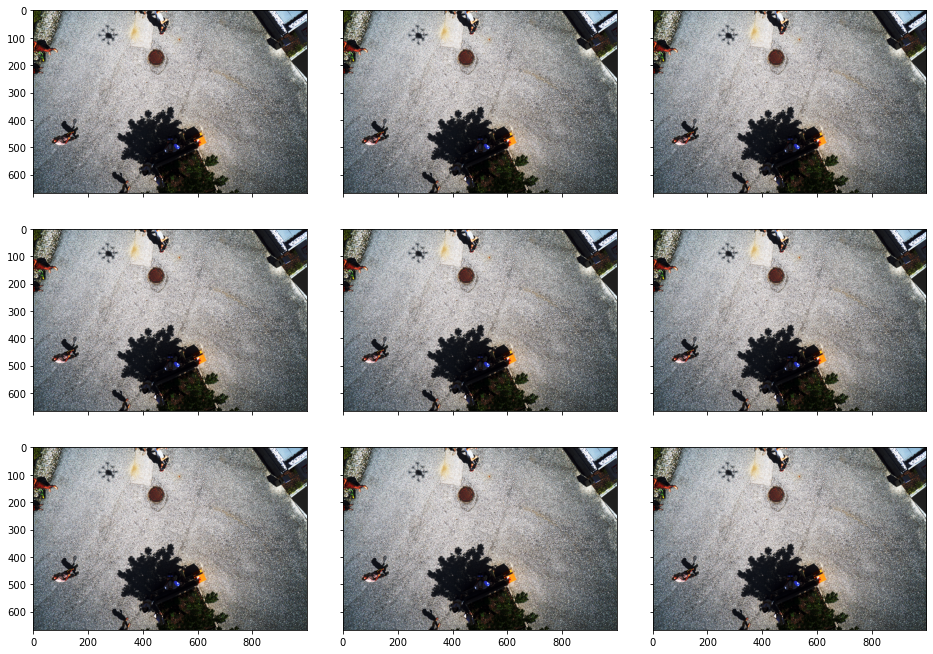

In [22]:
augments = A.Compose([
        A.Equalize(p=1)
])

aug_ims = []
for i in range(9):
    augmented = augments(image=image, mask=mask)

    aug_ims.append(augmented['image'])

vizzy(aug_ims)

## Posterize

This isn't that obvious to see but it might be a good idea. I don't use it much. It was used in the [AutoAugment research by Google Brain](https://arxiv.org/pdf/1805.09501.pdf).

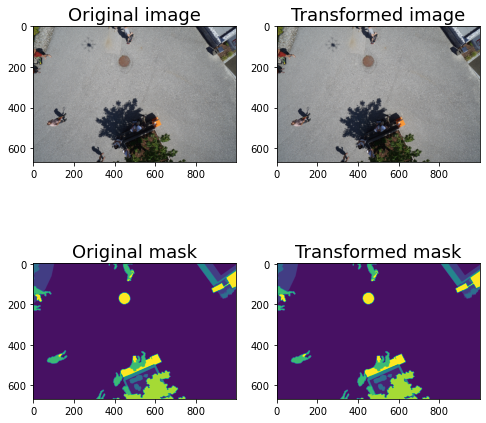

In [23]:
augments = A.Compose([
        A.Posterize(num_bits=4, p=0.5),
])

augmented = augments(image=image, mask=mask)

image_scaled = augmented['image']
mask_scaled = augmented['mask']

visualize(image_scaled, mask_scaled, original_image=image, original_mask=mask)

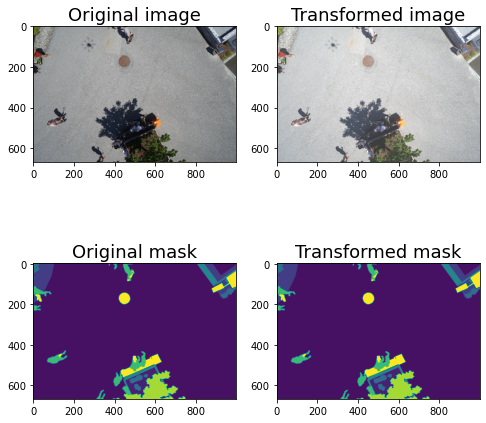

In [24]:
augments = A.Compose([
        A.RandomBrightness(limit=(0.2, 0.2), p=0.5),
])

augmented = augments(image=image, mask=mask)

image_scaled = augmented['image']
mask_scaled = augmented['mask']

visualize(image_scaled, mask_scaled, original_image=image, original_mask=mask)

### RandomBrightness

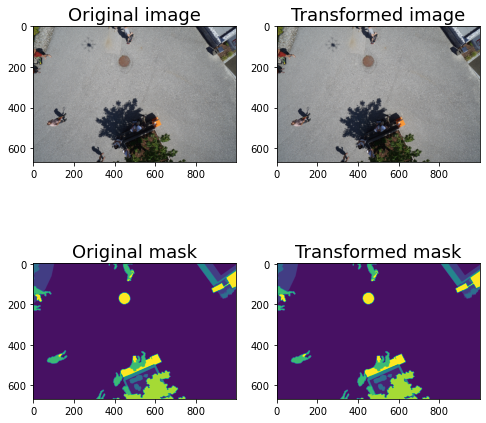

In [25]:
augments = A.Compose([
        A.RandomBrightness(limit=(0.3, 0.3), p=1),
])

aug_ims = []
augmented = augments(image=image, mask=mask)

aug_ims.append(augmented['image'])
augmented_image = augmented['image']
augmented_mask = augmented['mask']

visualize_no_mask(image, mask, original_image=image, original_mask=mask)

If you set a single value it will be plus or minus this value, which is what you'd actually want. Because it's a range I leave the probability at 100%.

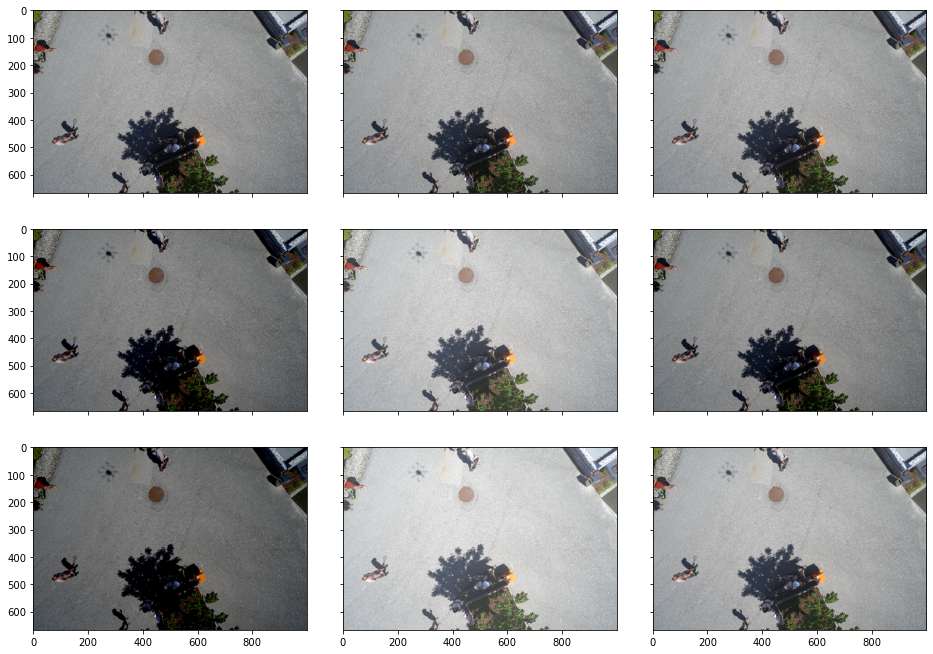

In [26]:
augments = A.Compose([
        A.RandomBrightness(limit=0.3, p=1),
])

aug_ims = []
for i in range(9):
    augmented = augments(image=image, mask=mask)

    aug_ims.append(augmented['image'])

vizzy(aug_ims)

### RandomConstrast

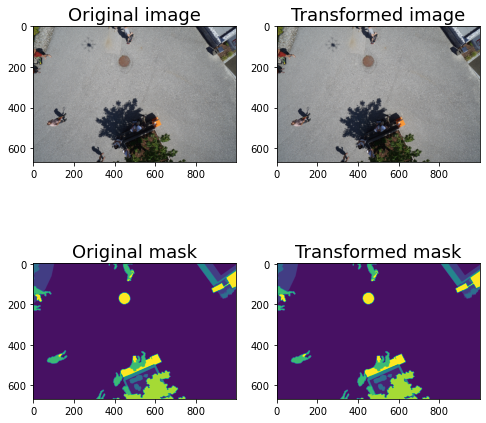

In [27]:
augments = A.Compose([
        A.RandomContrast(limit=0.2, p=1),
])

aug_ims = []
augmented = augments(image=image, mask=mask)

aug_ims.append(augmented['image'])
augmented_image = augmented['image']
augmented_mask = augmented['mask']

visualize_no_mask(image, mask, original_image=image, original_mask=mask)

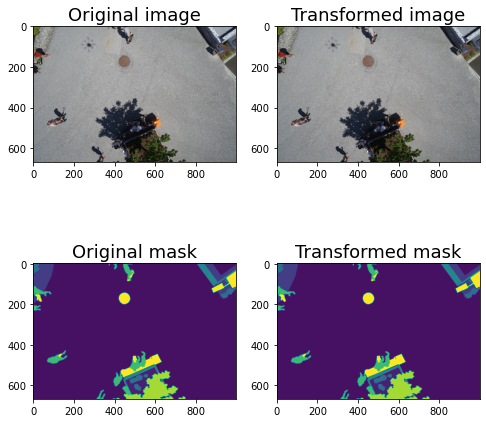

In [28]:
augments = A.Compose([
        A.RandomContrast(limit=0.2, p=1),
])

augmented = augments(image=image, mask=mask)

image_scaled = augmented['image']
mask_scaled = augmented['mask']

visualize(image_scaled, mask_scaled, original_image=image, original_mask=mask)

### RandomGamma

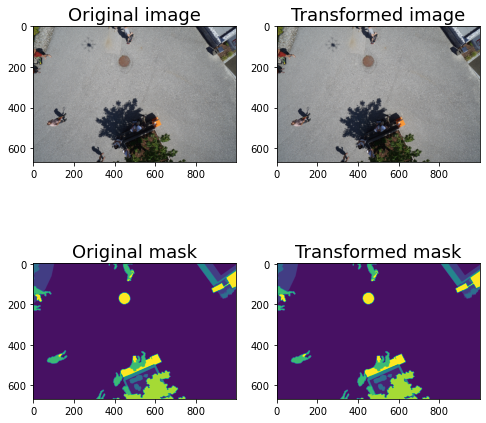

In [29]:
augments = A.Compose([
        A.RandomGamma(gamma_limit=(80, 120), p=1.0),
])

aug_ims = []
augmented = augments(image=image, mask=mask)

aug_ims.append(augmented['image'])
augmented_image = augmented['image']
augmented_mask = augmented['mask']

visualize_no_mask(image, mask, original_image=image, original_mask=mask)

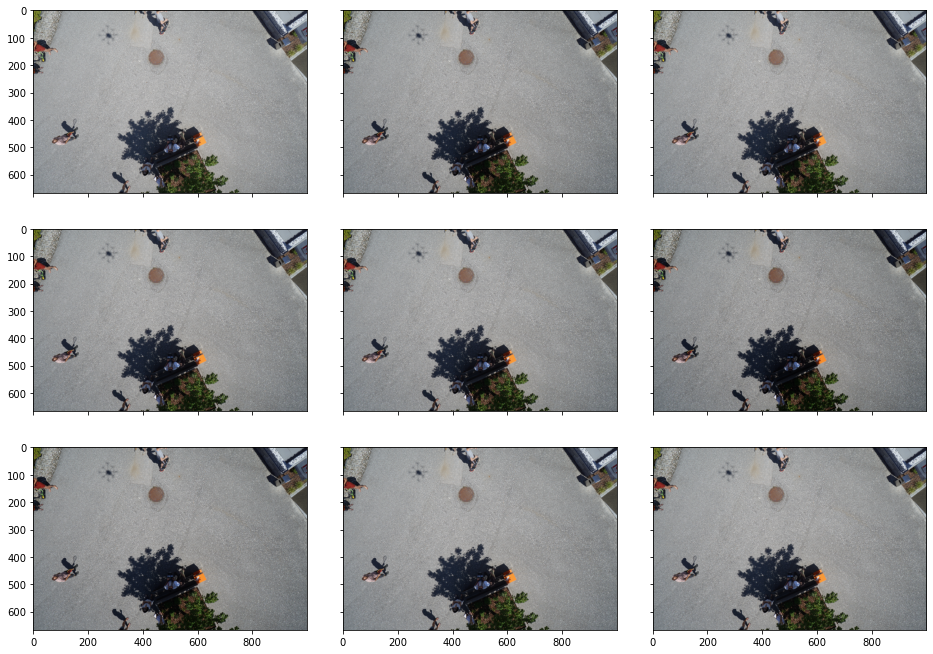

In [30]:
augments = A.Compose([
        A.RandomGamma(gamma_limit=(80, 120), p=0.5),
])

aug_ims = []
for i in range(9):
    augmented = augments(image=image, mask=mask)

    aug_ims.append(augmented['image'])

vizzy(aug_ims)

There are also a lot of distortions. Most of them seem like to significant a change for me. If you want a smaller one, you can always try `GridDistortion`.

Another thing to do during augmentation is convert everything to float... Is this needed?

In [31]:
A.ToFloat(max_value=255.0, p=1.0)

ToFloat(always_apply=False, p=1.0, max_value=255.0)

## Cropping

There are two cropping options: Crop and CenterCrop. Let's look at them.

In [32]:
def vizzy(augmented_images: List, fontsize = 18):

    fig = plt.figure(figsize=(16., 16.))
    grid = ImageGrid(fig, 111,
                     nrows_ncols=(3, 3),
                     axes_pad=0.5,
                     )

    for ax, im in zip(grid, augmented_images):
        # Iterating over the grid returns the Axes.
        ax.imshow(im)
        #ax.set_title('Augmented Image', fontsize=fontsize)

    plt.show()

In [33]:
aug = A.Compose([
        A.Crop(40, 40, 120, 120, p=0.5),
])

This reduces the image size. Sometimes this is what I'm looking for, other times I want to resize.

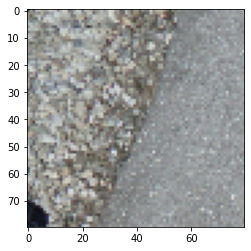

In [34]:
plt.imshow(aug(image=image, mask=mask)['image'])

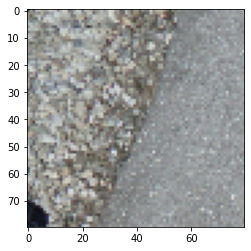

In [35]:
plt.imshow(aug(image=image, mask=mask)['image'])

Here's how to resize.

The arguments are a little unintuitive but they work just fine

In [36]:
w2h_ratio = image.shape[1] / image.shape[0]
print(w2h_ratio)

1.4992503748125936


In [37]:
image.shape[0]

667

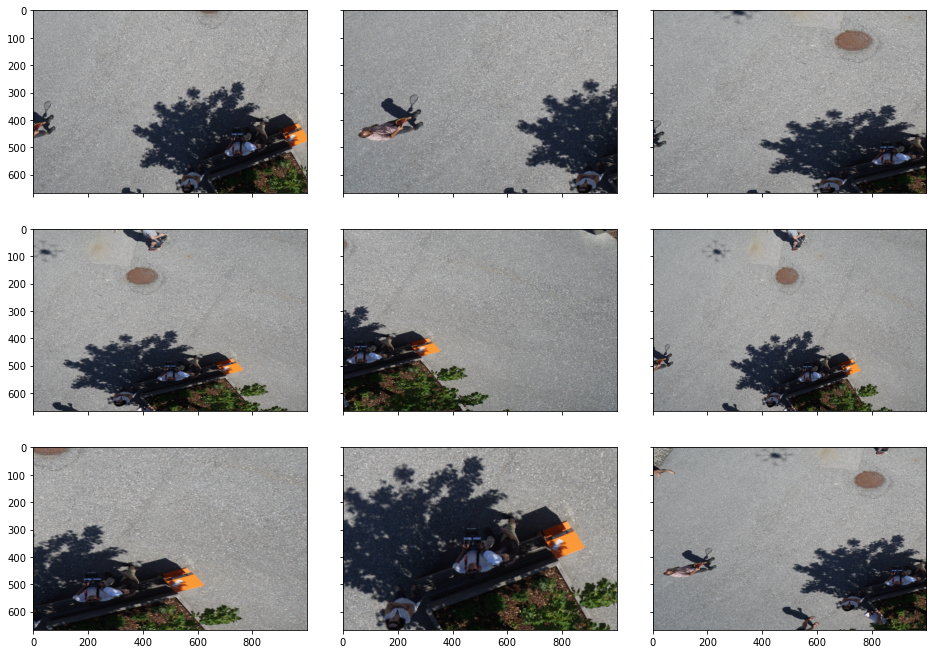

In [38]:
augments = A.Compose([
        A.RandomResizedCrop(image.shape[0], image.shape[1]),
])

aug_ims = []
for i in range(9):
    augmented = augments(image=image, mask=mask)

    aug_ims.append(augmented['image'])

vizzy(aug_ims)

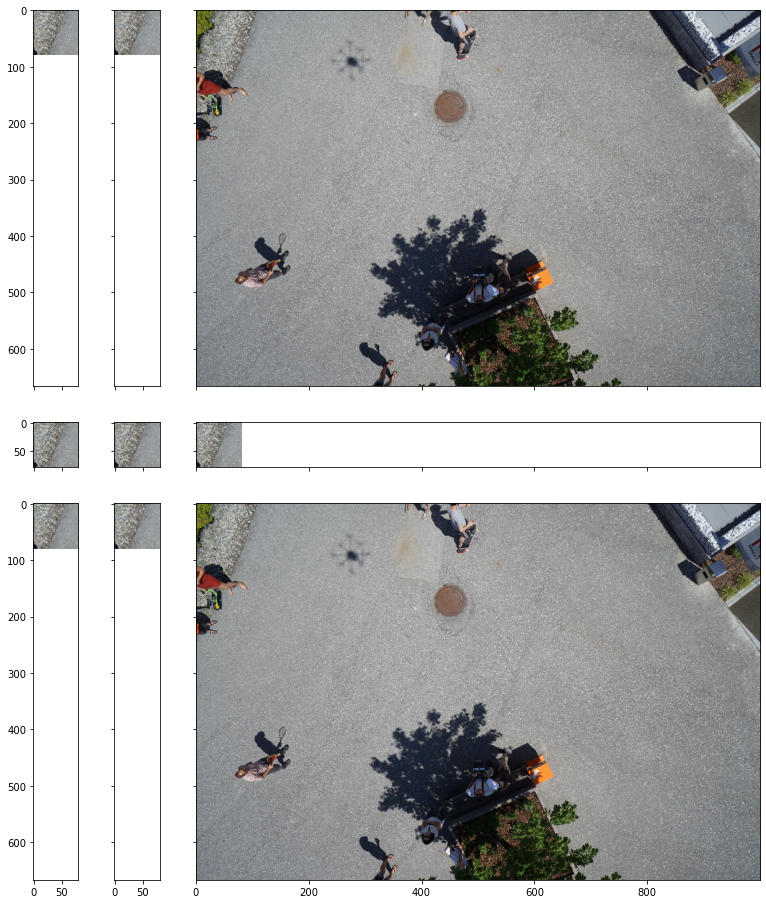

In [39]:
augments = A.Compose([
        A.Crop(40, 40, 120, 120, p=0.5),
])

aug_ims = []
for i in range(9):
    augmented = augments(image=image, mask=mask)

    aug_ims.append(augmented['image'])

vizzy(aug_ims)

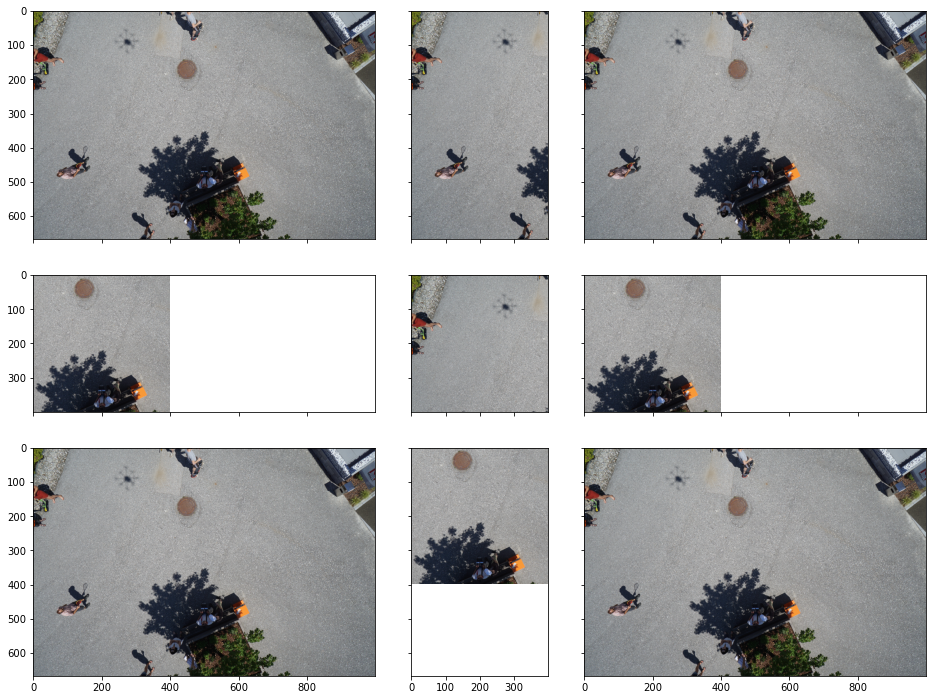

In [40]:
augments = A.Compose([
        A.CenterCrop(400, 400,always_apply=False, p=0.5),
])

aug_ims = []
for i in range(9):
    augmented = augments(image=image, mask=mask)

    aug_ims.append(augmented['image'])

vizzy(aug_ims)

## Overall

My overall usually looks something like this

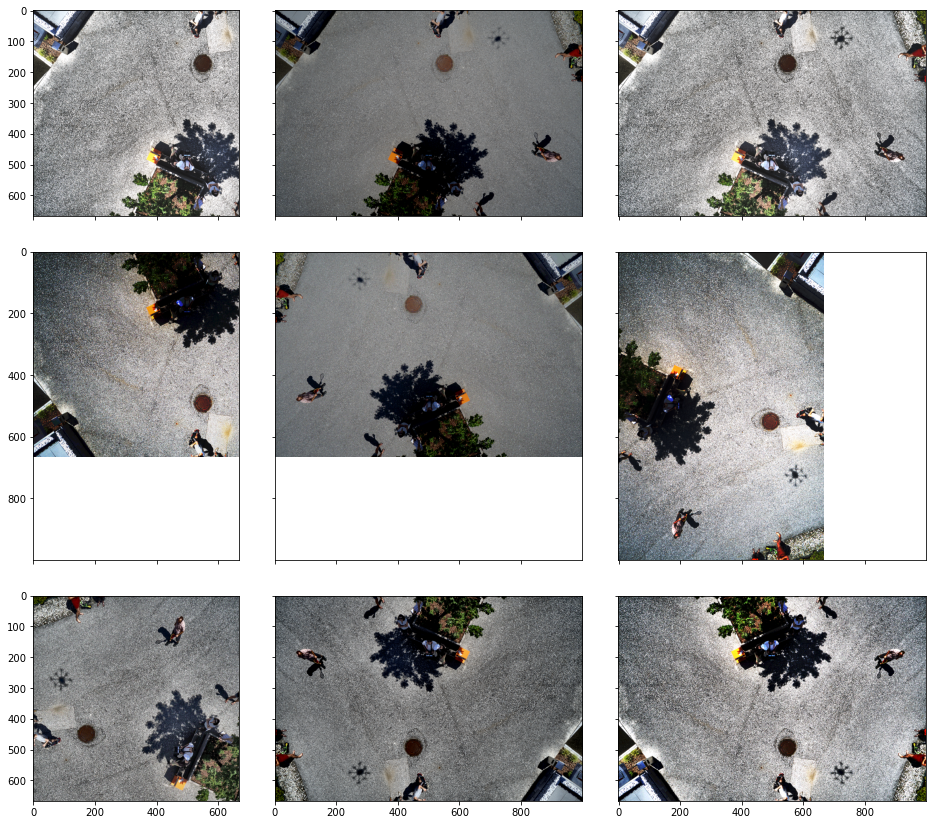

In [41]:
augments = A.Compose([
    # spatial-level transforms (no distortion)
        A.HorizontalFlip(p=0.5),
        A.VerticalFlip(p=0.5),
        A.RandomRotate90(p=0.5),
    # pixel-level transforms
        A.CLAHE(p=0.5),
        A.Equalize(p=0.5),
        A.Posterize(num_bits=4, p=0.5),
        A.RandomBrightness(limit=0.2, p=0.5),
        A.RandomContrast(limit=0.2, p=0.5),
        A.RandomGamma(gamma_limit=(80, 120), p=0.5),
])

aug_ims = []
for i in range(9):
    augmented = augments(image=image, mask=mask)

    aug_ims.append(augmented['image'])

vizzy(aug_ims)

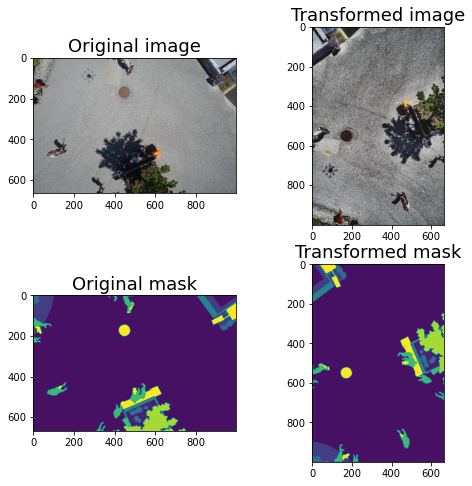

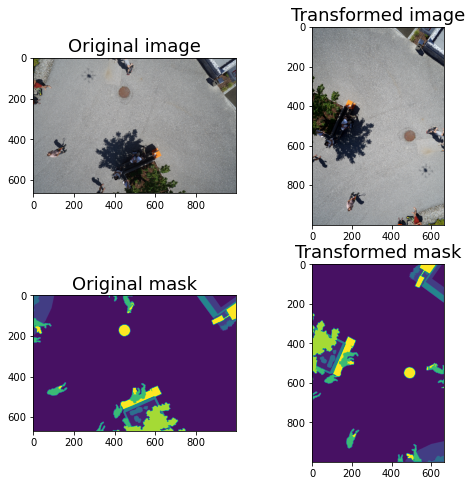

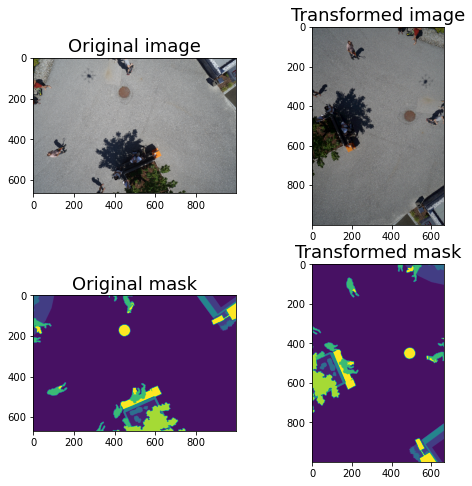

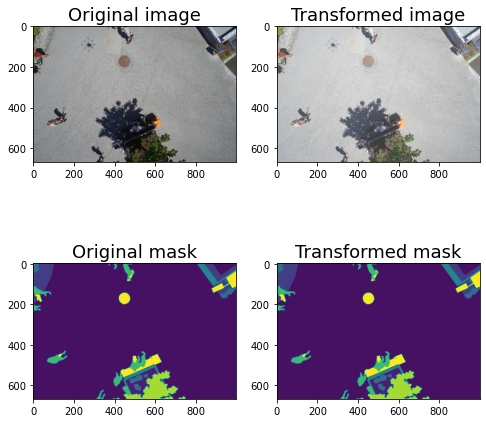

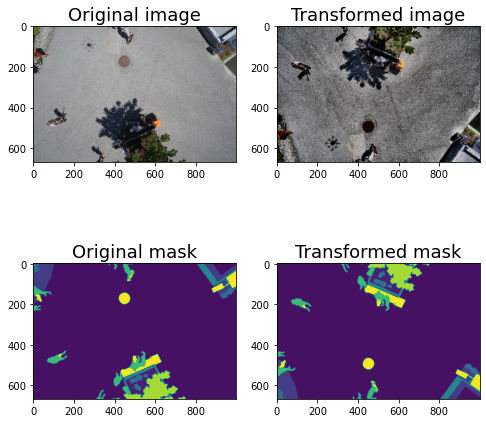

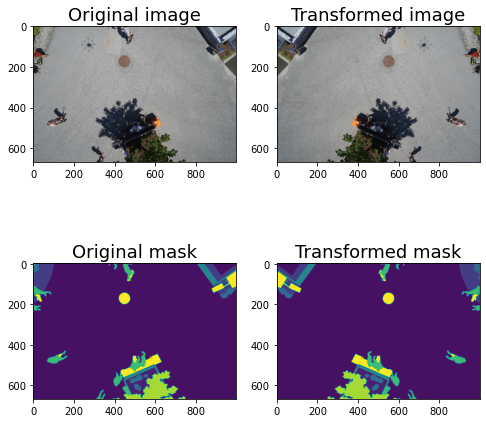

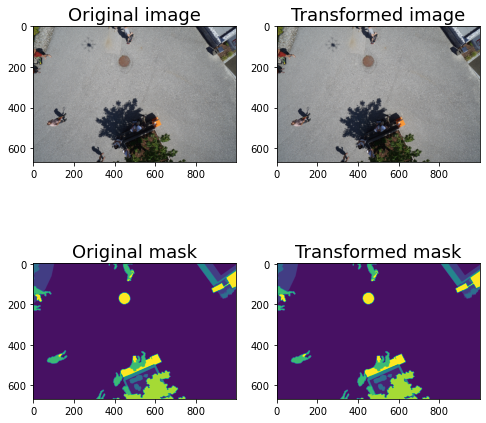

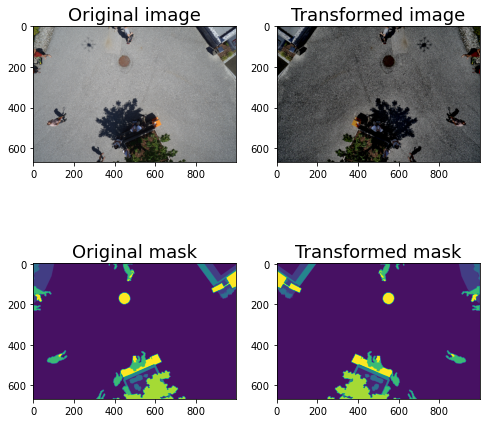

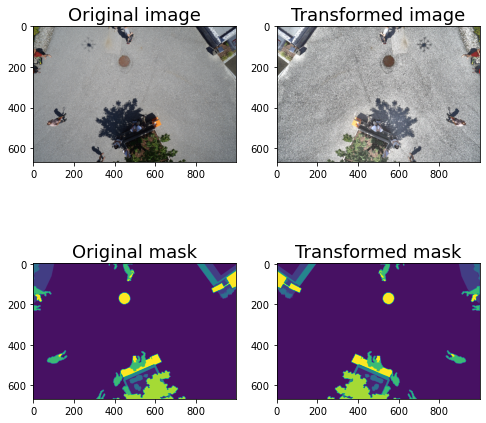

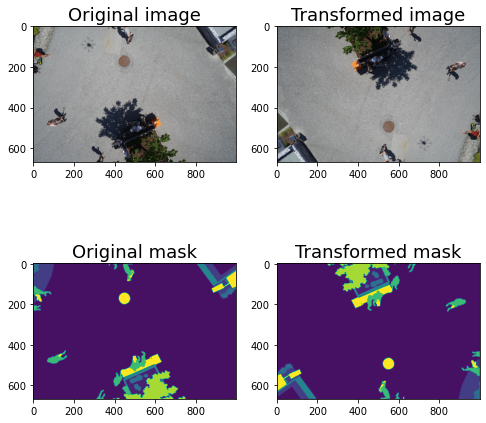

In [42]:
for i in range(10):
    augmented = augments(image=image, mask=mask)

    image_scaled = augmented['image']
    mask_scaled = augmented['mask']

    visualize(image_scaled, mask_scaled, original_image=image, original_mask=mask)

Or if you want to add cropping:

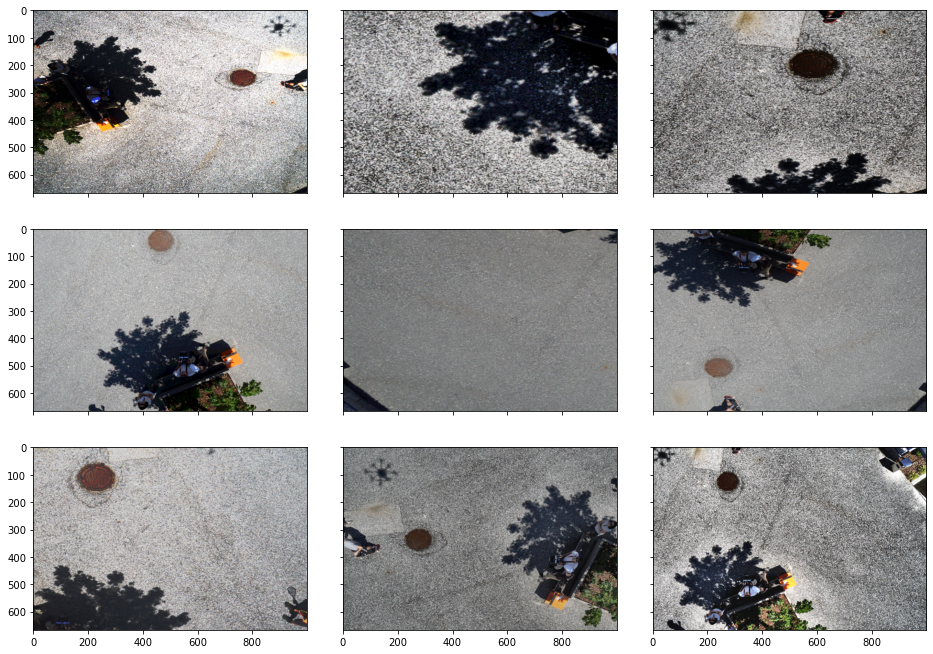

In [43]:
augments = A.Compose([
    # spatial-level transforms (no distortion)
        A.HorizontalFlip(p=0.5),
        A.VerticalFlip(p=0.5),
        A.RandomRotate90(p=0.5),
    # pixel-level transforms
        A.CLAHE(p=0.5),
        A.Equalize(p=0.5),
        A.Posterize(num_bits=4, p=0.5),
        A.RandomBrightness(limit=0.2, p=0.5),
        A.RandomContrast(limit=0.2, p=0.5),
        A.RandomGamma(gamma_limit=(80, 120), p=0.5),
    # cropping
        A.RandomResizedCrop(image.shape[0], image.shape[1])
])

aug_ims = []
for i in range(9):
    augmented = augments(image=image, mask=mask)

    aug_ims.append(augmented['image'])

vizzy(aug_ims)

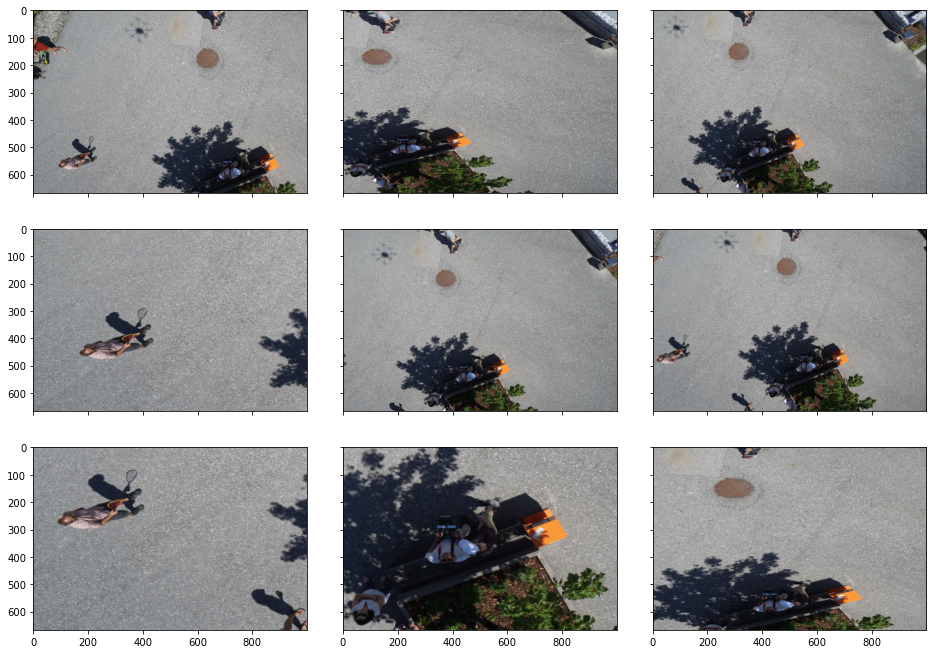

In [44]:
augments = A.Compose([
        A.RandomResizedCrop(image.shape[0], image.shape[1]),
])

aug_ims = []
for i in range(9):
    augmented = augments(image=image, mask=mask)

    aug_ims.append(augmented['image'])

vizzy(aug_ims)